# Imports and environment variables

In [39]:
# imports
#
import os
import glob
import numpy as np
import seaborn as sns
import plotly.express as px
import pandas as pd
import pprint

In [40]:
# versions of installed libraries
!conda env export

name: coursera_winkaggle
channels:
  - plotly
  - conda-forge
  - defaults
dependencies:
  - _libgcc_mutex=0.1=main
  - antlr-python-runtime=4.8=py38h32f6830_2
  - argon2-cffi=20.1.0=py38h25fe258_2
  - async_generator=1.10=py_0
  - attrs=20.3.0=pyhd3deb0d_0
  - backcall=0.2.0=pyh9f0ad1d_0
  - backports=1.0=py_2
  - backports.functools_lru_cache=1.6.1=py_0
  - blas=1.0=openblas
  - bleach=3.2.1=pyh9f0ad1d_0
  - brotlipy=0.7.0=py38h8df0ef7_1001
  - ca-certificates=2020.12.5=ha878542_0
  - catboost=0.24.3=py38h578d9bd_0
  - certifi=2020.12.5=py38h578d9bd_0
  - cffi=1.14.4=py38h261ae71_0
  - chardet=3.0.4=py38h924ce5b_1008
  - click=7.1.2=py_0
  - cloudpickle=1.6.0=py_0
  - cryptography=3.2.1=py38h7699a38_0
  - cycler=0.10.0=py38_0
  - dbus=1.13.18=hb2f20db_0
  - decorator=4.4.2=py_0
  - defusedxml=0.6.0=py_0
  - entrypoints=0.3=pyhd8ed1ab_1003
  - expat=2.2.10=he6710b0_2
  - fontconfig=2.13.0=h9420a91_0
  - freetype=2.10.4=h5ab3b9f_0
  - future=0.18.2=py38h578d9bd_2
  - glib=2.66.1=h92f70

In [41]:
# set rootpath (so that works both locally and in kaggle interactive notebook)
if os.path.isdir('../data'):
    rootpath='../data'
else:
    rootpath='/kaggle/input/competitive-data-science-predict-future-sales'
assert os.path.isdir(rootpath), "rootpath={} does NOT exist".format(rootpath)
paths = glob.glob(rootpath + '/*')
pprint.pprint(paths)

['../data/sales_train.csv',
 '../data/sample_submission.csv',
 '../data/items.csv',
 '../data/test.csv',
 '../data/shops.csv',
 '../data/item_categories.csv']


# Problem description

The goal of this competition is to predict how much items will be sold in November 2015 per item ID and per shop ID. In order to predict these values, we are given sales data for the time period of January 2013 to October 2015.

The predictions are evaluated according to the root mean squared error (RMSE).

In [42]:
# Shall we predict sales also per shop ID? -> Yes, per item ID AND per shop ID, see test.csv below
test = pd.read_csv(os.path.join(rootpath, 'test.csv'))
test.tail()

,ID,shop_id,item_id
214195,214195,45,18454
214196,214196,45,16188
214197,214197,45,15757
214198,214198,45,19648
214199,214199,45,969


In [43]:
sub_sample = pd.read_csv(os.path.join(rootpath, 'sample_submission.csv'))
sub_sample.tail()

,ID,item_cnt_month
214195,214195,0.5
214196,214196,0.5
214197,214197,0.5
214198,214198,0.5
214199,214199,0.5


# Which information do we have?

- item_categories.csv -> name of category in Russian
- items.csv -> name of item in Russian and category ID
- sales_train.csv -> probably most important information. Contains number of sold items per item_id, per shop_id, per date. Also includes item price
- shop.csv -> name fo shop in Russian

In [44]:
filenames = os.listdir(rootpath)
filenames.sort()
dfs = dict()
for f in filenames:
    df = pd.read_csv(os.path.join(rootpath, f))
    print("{} looks like this".format(f))
    display(df.tail())
    dfs[f[:-4]]=df

item_categories.csv looks like this


,item_category_name,item_category_id
79,Служебные,79
80,Служебные - Билеты,80
81,Чистые носители (шпиль),81
82,Чистые носители (штучные),82
83,Элементы питания,83


items.csv looks like this


,item_name,item_id,item_category_id
22165,"Ядерный титбит 2 [PC, Цифровая версия]",22165,31
22166,Язык запросов 1С:Предприятия [Цифровая версия],22166,54
22167,Язык запросов 1С:Предприятия 8 (+CD). Хрустале...,22167,49
22168,Яйцо для Little Inu,22168,62
22169,Яйцо дракона (Игра престолов),22169,69


sales_train.csv looks like this


,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
2935844,10.10.2015,33,25,7409,299.0,1.0
2935845,09.10.2015,33,25,7460,299.0,1.0
2935846,14.10.2015,33,25,7459,349.0,1.0
2935847,22.10.2015,33,25,7440,299.0,1.0
2935848,03.10.2015,33,25,7460,299.0,1.0


sample_submission.csv looks like this


,ID,item_cnt_month
214195,214195,0.5
214196,214196,0.5
214197,214197,0.5
214198,214198,0.5
214199,214199,0.5


shops.csv looks like this


,shop_name,shop_id
55,Цифровой склад 1С-Онлайн,55
56,"Чехов ТРЦ ""Карнавал""",56
57,"Якутск Орджоникидзе, 56",57
58,"Якутск ТЦ ""Центральный""",58
59,"Ярославль ТЦ ""Альтаир""",59


test.csv looks like this


,ID,shop_id,item_id
214195,214195,45,18454
214196,214196,45,16188
214197,214197,45,15757
214198,214198,45,19648
214199,214199,45,969


In [45]:
# Is date_block_num the same as month_year? -> Yes exactly the same 
train = dfs['sales_train']
train['month_year'] = train['date'].str.slice(start=3)
train['month'] = train['date'].str.slice(start=3, stop=5).astype(int)
train['year'] = train['date'].str.slice(start=6).astype(int)
display(train.head())
train.groupby(['date_block_num', 'month_year'])['month_year'].count()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,month_year,month,year
0,02.01.2013,0,59,22154,999.00,1.0,01.2013,1,2013
1,03.01.2013,0,25,2552,899.00,1.0,01.2013,1,2013
2,05.01.2013,0,25,2552,899.00,-1.0,01.2013,1,2013
3,06.01.2013,0,25,2554,1709.05,1.0,01.2013,1,2013
4,15.01.2013,0,25,2555,1099.00,1.0,01.2013,1,2013


date_block_num  month_year
0               01.2013       115690
1               02.2013       108613
2               03.2013       121347
3               04.2013        94109
4               05.2013        91759
5               06.2013       100403
6               07.2013       100548
7               08.2013       104772
8               09.2013        96137
9               10.2013        94202
10              11.2013        96736
11              12.2013       143246
12              01.2014        99349
13              02.2014        89830
14              03.2014        92733
15              04.2014        77906
16              05.2014        78529
17              06.2014        82408
18              07.2014        78760
19              08.2014        86614
20              09.2014        73157
21              10.2014        79361
22              11.2014        86428
23              12.2014       130786
24              01.2015        88522
25              02.2015        71808
26         

In [46]:
# Do we have to predict on all combinations of itemIDs and shopIDs?
test = dfs['test']
nshops = test['shop_id'].nunique()
nitems = test['item_id'].nunique()
print("test has {} rows. Possible combinations would be {}"
     .format(len(test), nshops*nitems))

test has 214200 rows. Possible combinations would be 214200


# Difference between test.csv and train.csv

In [47]:
# What shops are in test.csv compared to train.csv? -> 42/60 shops from train.csv, no new ones
train = dfs['sales_train']
test = dfs['test']

key = 'shop_id'
dct = {'train': set(train[key].unique()), 
       'test': set(test[key].unique()),
      }
print("new={}".format(len(dct['test'] - dct['train'])))
print("overlapping={}".format(len(dct['test'] & dct['train'])))
print("missing={}".format(len(dct['train'] - dct['test'])))

new=0
overlapping=42
missing=18


In [48]:
# What item IDs are in test.csv compared to train.csv? -> only ~25% items from train.csv plus a few new ones!
key = 'item_id'
dct = {'train': set(train[key].unique()), 
       'test': set(test[key].unique()),
      }
print("new={}".format(len(dct['test'] - dct['train'])))
print("overlapping={}".format(len(dct['test'] & dct['train'])))
print("missing={}".format(len(dct['train'] - dct['test'])))

new=363
overlapping=4737
missing=17070


In [49]:
# What are the new IDs? -> afew IDs 
new_ids = list(dct['test'] - dct['train'])
new_ids.sort()
print("new item IDs are {}".format(new_ids))

new item IDs are [83, 140, 168, 173, 204, 237, 249, 254, 302, 402, 428, 430, 454, 480, 566, 639, 640, 762, 892, 900, 907, 1184, 1193, 1246, 1252, 1253, 1254, 1284, 1386, 1394, 1434, 1436, 1437, 1574, 1575, 1577, 1580, 1585, 1679, 1683, 1732, 1864, 1867, 1884, 1885, 2322, 2323, 2324, 2325, 2326, 2327, 2328, 2420, 2426, 2427, 2428, 2434, 2569, 2722, 2966, 3022, 3023, 3271, 3272, 3273, 3282, 3284, 3338, 3349, 3354, 3405, 3407, 3408, 3538, 3571, 3579, 3604, 3627, 3760, 3867, 3908, 3984, 4060, 4156, 4310, 4318, 4412, 4642, 4925, 5025, 5064, 5121, 5248, 5268, 5269, 5320, 5321, 5322, 5441, 5541, 5569, 5667, 5721, 5722, 5812, 5826, 5843, 5844, 5961, 5963, 6152, 6153, 6169, 6259, 6335, 6439, 6519, 6520, 6521, 6522, 6523, 6524, 6525, 6526, 6527, 6528, 6529, 6530, 6531, 6532, 6533, 6645, 6729, 6730, 6731, 6732, 6733, 6734, 6742, 6743, 6863, 6891, 6903, 6996, 7094, 7124, 7572, 7592, 7607, 7646, 7647, 7669, 7727, 7728, 7729, 7730, 7766, 7782, 7862, 7926, 8182, 8191, 8337, 8354, 8355, 8545, 8549, 85

In [50]:
# Do we have category labels for all of them? -> Yes, we do :)
items = dfs['items']
for ni in new_ids:
    assert ni in items.index, "item_id={} not in items.csv!"

In [51]:
# What item categorys are in test.csv compared to train.csv? -> Using 62/84 categories from train.csv. No new ones
items = dfs['items']
train['item_cat'] = items.loc[train['item_id'], 'item_category_id'].values
test['item_cat'] = items.loc[test['item_id'], 'item_category_id'].values
key = 'item_cat'
dct = {'train': set(train[key].unique()), 
       'test': set(test[key].unique()),
      }
print("new={}".format(len(dct['test'] - dct['train'])))
print("overlapping={}".format(len(dct['test'] & dct['train'])))
print("missing={}".format(len(dct['train'] - dct['test'])))

new=0
overlapping=62
missing=22


# Monthly sales per item, per shop

In [52]:
# Most items are only sold a few times
for item_id in [100,1000,19000]:
    df = train.loc[train['item_id']==item_id,:]
    df = df.pivot_table(values='item_cnt_day',
                          aggfunc='sum',
                            index='date_block_num',
                            columns='shop_id'
                          )
    df.fillna(0,inplace=True)
    display(px.imshow(df))

In [53]:
import itertools
df = train.groupby(['date_block_num','shop_id','item_id'])['item_cnt_day'].sum()
df = df.reset_index()
df['item_cnt_day'] = df['item_cnt_day'].apply(lambda x: np.clip(x,0,20))
display(df.head())


print("median={}".format(df['item_cnt_day'].median()))
print("mean={}".format(df['item_cnt_day'].mean()))

,date_block_num,shop_id,item_id,item_cnt_day
0,0,0,32,6.0
1,0,0,33,3.0
2,0,0,35,1.0
3,0,0,43,1.0
4,0,0,51,2.0


median=1.0
mean=2.022806197657856


# Fixing invalid values

In [54]:
# are there any empty/Nan values? -> No
train.isna().sum()

date              0
date_block_num    0
shop_id           0
item_id           0
item_price        0
item_cnt_day      0
month_year        0
month             0
year              0
item_cat          0
dtype: int64

### Prices

In [55]:
# Are all item prices valid? -> No, one row with item_id 2973 is bad
print("min item price={}".format(train['item_price'].min()))
mask_wrong = train['item_price']<=0
display(train.loc[mask_wrong,:])

min item price=-1.0


,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,month_year,month,year,item_cat
484683,15.05.2013,4,32,2973,-1.0,1.0,05.2013,5,2013,19


In [56]:
# With which value shall it be replaced? -> 1249.0
item1 = 2973
mask_id = train['item_id']==item1
mask_shop = train['shop_id']==32
mask_time = train['date_block_num']==4
tmp = train.loc[mask_id & mask_time,:]

display(tmp.sort_values(by='date').head(50))

train.loc[mask_wrong, 'item_price'] = 1249.0
display(train.loc[mask_wrong,:])

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,month_year,month,year,item_cat
465055,01.05.2013,4,44,2973,2499.0,1.0,05.2013,5,2013,19
479783,02.05.2013,4,31,2973,2499.0,1.0,05.2013,5,2013,19
479782,03.05.2013,4,31,2973,2499.0,1.0,05.2013,5,2013,19
469950,03.05.2013,4,45,2973,2499.0,1.0,05.2013,5,2013,19
531333,03.05.2013,4,6,2973,2499.0,1.0,05.2013,5,2013,19
442065,04.05.2013,4,28,2973,2499.0,1.0,05.2013,5,2013,19
445020,05.05.2013,4,27,2973,2499.0,1.0,05.2013,5,2013,19
484684,06.05.2013,4,32,2973,2499.0,1.0,05.2013,5,2013,19
479781,07.05.2013,4,31,2973,2499.0,1.0,05.2013,5,2013,19
531332,08.05.2013,4,6,2973,2499.0,1.0,05.2013,5,2013,19


,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,month_year,month,year,item_cat
484683,15.05.2013,4,32,2973,1249.0,1.0,05.2013,5,2013,19


In [57]:
# are all item_ids and shop IDs valid? -> Yes
assert all(train['item_id'] <= dfs['items']['item_id'].max()), "Some item IDs are invalid"
assert all(train['shop_id'] <= dfs['shops']['shop_id'].max()), "Some shop IDS are invalid"
print("all safe")

all safe


# Analysis of item_cnt

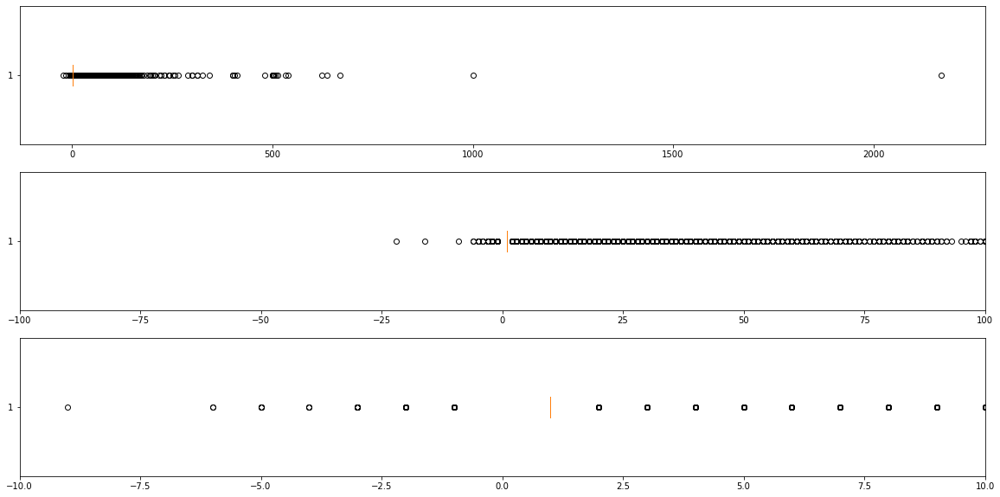

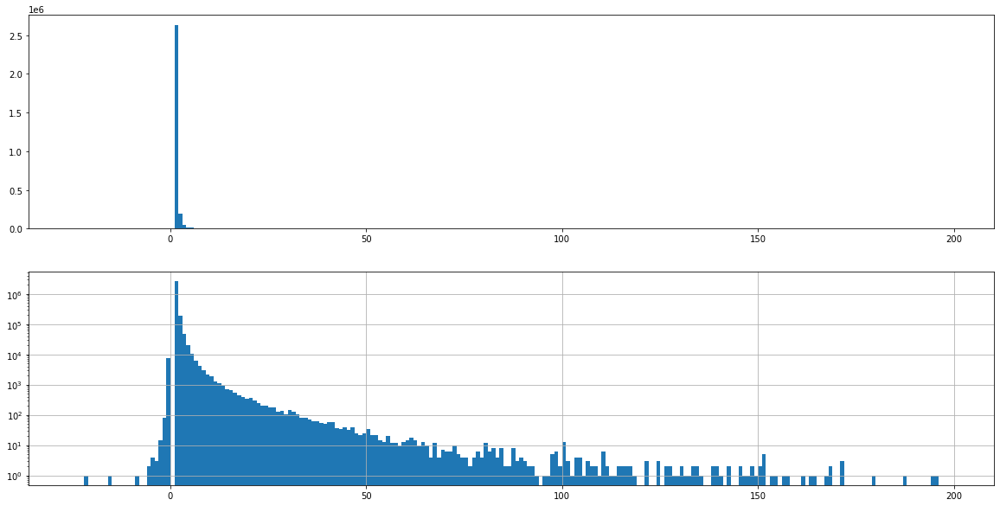

In [58]:
# Distribution of item_cnt -> Most items are sold only a few times
import matplotlib.pyplot as plt

fig, axes = plt.subplots(3,1,figsize=(20,10))
axes[0].boxplot(train['item_cnt_day'], vert=False);
axes[1].boxplot(train['item_cnt_day'], vert=False);
axes[1].set_xlim([-100,100])
axes[2].boxplot(train['item_cnt_day'], vert=False);
axes[2].set_xlim([-10,10])

fig,axes = plt.subplots(2,1,figsize=(20,10))
axes[0].hist(train['item_cnt_day'], bins=np.arange(-25,200), log=False);
axes[1].hist(train['item_cnt_day'], bins=np.arange(-25,200), log=True);
axes[1].grid(True)
# axes[2].violinplot(train['item_cnt_day'], vert=False);
# axes[2].set_xlim([0,100])

In [59]:
# ~90% of the sales are in quantities of 1. ~99.4% of the sales are in quantites in [1,10]
for i in range(10):
    nitems = np.sum(train['item_cnt_day']==i)
    print("{:.2%}={} of items are sold {} times".format(nitems/len(train), nitems, i))
    
mask = np.logical_and(0<=train['item_cnt_day'], train['item_cnt_day']<=10)
print("\n{:.2%}={} of sales are in quantities between [1,10]".format(sum(mask)/len(mask), sum(mask)))

0.00%=0 of items are sold 0 times
89.56%=2629372 of items are sold 1 times
6.61%=194201 of items are sold 2 times
1.61%=47350 of items are sold 3 times
0.67%=19685 of items are sold 4 times
0.36%=10474 of items are sold 5 times
0.22%=6338 of items are sold 6 times
0.14%=4057 of items are sold 7 times
0.10%=2903 of items are sold 8 times
0.07%=2177 of items are sold 9 times

99.40%=2918377 of sales are in quantities between [1,10]


In [60]:
# These are the outlier sales, which deal with quantities of more than 500.
# Note that certain IDs appear more often than others!
mask_outlier = train['item_cnt_day'] > 500
train.loc[mask_outlier,:].sort_values(by='item_id').head(100)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,month_year,month,year,item_cat
2608040,14.04.2015,27,12,3731,1904.548077,624.0,04.2015,4,2015,30
1573253,22.04.2014,15,27,8057,1200.000000,502.0,04.2014,4,2014,32
2048518,02.10.2014,21,12,9242,1500.000000,512.0,10.2014,10,2014,8
2864235,30.09.2015,32,12,9248,1692.526158,669.0,09.2015,9,2015,80
2864260,29.09.2015,32,12,9248,1500.000000,504.0,09.2015,9,2015,80
2851073,29.09.2015,32,55,9249,1500.000000,533.0,09.2015,9,2015,8
2851091,30.09.2015,32,55,9249,1702.825746,637.0,09.2015,9,2015,8
2626181,19.05.2015,28,12,11373,155.192950,539.0,05.2015,5,2015,9
2909818,28.10.2015,33,12,11373,0.908714,2169.0,10.2015,10,2015,9
2067669,09.10.2014,21,55,19437,899.000000,508.0,10.2014,10,2014,31


In [61]:
# Mean quantity sold and number of sales with more than 10 items correlate only slightly
cnt_per_itemid = train.loc[train['item_cnt_day'] > 0,:].groupby('item_id').agg(cnt=('shop_id', 'count'))
outliercnt_per_itemid = train.loc[train['item_cnt_day'] > 10,:].groupby('item_id').agg(outliercnt=('shop_id', 'count'))
cnt_per_itemid = cnt_per_itemid.join(outliercnt_per_itemid, rsuffix='outlier')
cnt_per_itemid['outliercnt'].fillna(value=0, inplace=True)
cnt_per_itemid['outlier_fraction'] = cnt_per_itemid['outliercnt'] / cnt_per_itemid['cnt'] 
cnt_per_itemid.head()


,cnt,outliercnt,outlier_fraction
item_id,,,
0,1,0.0,0.0
1,6,0.0,0.0
2,2,0.0,0.0
3,2,0.0,0.0
4,1,0.0,0.0


In [62]:
tmp = train.groupby('item_id')['item_cnt_day'].agg(['mean','median','max','min', 'std'])
tmp['std2'] = tmp['std'] / (tmp['mean']+1e-6)
tmp = tmp.join(cnt_per_itemid)
tmp = tmp.rename(columns={'shop_id': 'outlier_cnt'})
display(tmp.sort_values(by='mean', ascending=False).head(10))
display(tmp.sort_values(by='outlier_fraction', ascending=False).head(10))

,mean,median,max,min,std,std2,cnt,outliercnt,outlier_fraction
item_id,,,,,,,,,
3730,65.473684,51.0,231.0,1.0,52.442951,0.800978,19.0,17.0,0.894737
10199,48.000000,63.0,91.0,1.0,36.905284,0.768860,5.0,4.0,0.800000
19437,41.272727,2.0,508.0,1.0,112.411430,2.723625,33.0,7.0,0.212121
19445,39.375000,4.0,412.0,1.0,88.718320,2.253164,24.0,8.0,0.333333
4392,35.000000,1.0,115.0,1.0,47.696960,1.362770,7.0,3.0,0.428571
4201,32.666667,11.0,110.0,1.0,44.688552,1.368017,6.0,3.0,0.500000
19446,29.263158,1.0,151.0,1.0,44.738552,1.528835,19.0,9.0,0.473684
9248,27.934426,2.0,669.0,1.0,106.923628,3.827665,61.0,12.0,0.196721
9249,27.934426,2.0,637.0,1.0,106.010985,3.794994,61.0,12.0,0.196721


,mean,median,max,min,std,std2,cnt,outliercnt,outlier_fraction
item_id,,,,,,,,,
4158,15.000000,15.0,15.0,15.0,NaN,NaN,1.0,1.0,1.000000
3730,65.473684,51.0,231.0,1.0,52.442951,0.800978,19.0,17.0,0.894737
10199,48.000000,63.0,91.0,1.0,36.905284,0.768860,5.0,4.0,0.800000
3727,19.166667,20.0,31.0,7.0,9.347014,0.487670,6.0,4.0,0.666667
3729,15.357143,12.0,52.0,4.0,12.683164,0.825880,14.0,8.0,0.571429
4201,32.666667,11.0,110.0,1.0,44.688552,1.368017,6.0,3.0,0.500000
1929,6.750000,7.0,12.0,1.0,5.560276,0.823744,4.0,2.0,0.500000
13642,7.250000,6.0,16.0,1.0,7.500000,1.034483,4.0,2.0,0.500000
19446,29.263158,1.0,151.0,1.0,44.738552,1.528835,19.0,9.0,0.473684


In [63]:
# There seems to be a small linear relation between mean and outlier_fraction. This is expected
# The normalized standard deviation std2 doesn't seem to relate to anything
px.scatter_matrix(tmp.loc[:,['mean','outliercnt','outlier_fraction', 'std2']])

In [64]:
# At least for all items, there is a strong decline in sales over the years! Also a high peak in December
train2 = train.groupby(['month_year']).agg({'item_cnt_day':'sum'})
train2['datetime'] = pd.to_datetime(train2.index, format="%m.%Y")
train2.sort_values(by='datetime', inplace=True)
train2.reset_index(inplace=True)
display(train2.tail())
px.line(train2,x='datetime',y='item_cnt_day', title='total sales per month for ALL items')

,month_year,item_cnt_day,datetime
29,06.2015,64114.0,2015-06-01
30,07.2015,63187.0,2015-07-01
31,08.2015,66079.0,2015-08-01
32,09.2015,72843.0,2015-09-01
33,10.2015,71056.0,2015-10-01


In [65]:
# However, items in test actually increase a lot! Only items not in test seem to increase, even go to zero
train['in_test'] = train['item_id'].isin(set(test['item_id']))
train['my'] = pd.to_datetime(train['month_year'], format="%m.%Y")
train['dmy'] = pd.to_datetime(train['date'], format="%d.%m.%Y")
train.head()

tmp = train.pivot_table(values='item_cnt_day', aggfunc='sum', index='my', columns=['in_test'])
display(tmp.head())
px.line(tmp, color='in_test')

in_test,False,True
my,,
2013-01-01,102702.0,28777.0
2013-02-01,97656.0,30434.0
2013-03-01,107007.0,40135.0
2013-04-01,81094.0,26096.0
2013-05-01,78381.0,28589.0


In [66]:
# A lot of items are only sold for a few months at all
tmp = train.pivot_table(values='item_cnt_day', aggfunc='sum', index='my', columns='item_id')
tmp.fillna(value=0, inplace=True)
display(tmp.head())

tmp2 = tmp.rolling(window=3, center=True).mean()
tmp2 = tmp2 / tmp2.sum(axis=0)
display(tmp2.head())

px.line(tmp2.iloc[:,::2000], color='item_id', range_y=(0,0.5))

item_id,0,1,2,3,4,5,6,7,8,9,...,22160,22161,22162,22163,22164,22165,22166,22167,22168,22169
my,,,,,,,,,,,,,,,,,,,,,
2013-01-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,11.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
2013-02-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
2013-03-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2013-04-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-05-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


item_id,0,1,2,3,4,5,6,7,8,9,...,22160,22161,22162,22163,22164,22165,22166,22167,22168,22169
my,,,,,,,,,,,,,,,,,,,,,
2013-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-02-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.203390,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.416667,0.0
2013-03-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.127119,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0
2013-04-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.118644,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.083333,0.0
2013-05-01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.101695,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [67]:
# How many months are items sold? Are they one-hit wonders or sold all the time?
# -> 13% are sold in only one month. Very few (<5%) are sold for more than 30 months
nmonth_with_sales = (tmp > 0).sum(axis=0)
px.histogram(nmonth_with_sales, histnorm='probability')

In [68]:
# How many month exist where at least 0% / 10% /  50% of total sales are made?
# -> 23% items have at least 50% of their sales in one month (and thus <50% of sales in all other months combined!)
#    These items can be considered one hit wonders and might be difficult to predict if not e.g. each December.
# -> Only 6% items are "evenly" distributed such that each month has <10% of total sales
totsales_per_item = tmp.sum(axis=0)
nmonth_per_fraction = dict()
for fraction in [0,0.1,0.5]:
    nmonths_per_item = (tmp > fraction*totsales_per_item).sum(axis=0)
    nmonth_per_fraction[fraction] = nmonths_per_item    

px.histogram(nmonth_per_fraction, barmode='overlay', histnorm='probability')

In [69]:
# Since the difference in test items seems pretty significant: Were the items in test even sold in 2014 and 2015?
train['datetime'] = pd.to_datetime(train['date'], format="%d.%m.%Y")
for year in [2013,2014,2015]:
    mask = np.logical_and(pd.Timestamp(year,1,1)<=train['datetime'], train['datetime']<=pd.Timestamp(year,12,30))
    col = 'cnt_{}'.format(year)
    train[col] = 0
    train.loc[mask,col] = train.loc[mask,'item_cnt_day']
train.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,month_year,month,year,item_cat,in_test,my,dmy,datetime,cnt_2013,cnt_2014,cnt_2015
0,02.01.2013,0,59,22154,999.00,1.0,01.2013,1,2013,37,True,2013-01-01,2013-01-02,2013-01-02,1.0,0.0,0.0
1,03.01.2013,0,25,2552,899.00,1.0,01.2013,1,2013,58,False,2013-01-01,2013-01-03,2013-01-03,1.0,0.0,0.0
2,05.01.2013,0,25,2552,899.00,-1.0,01.2013,1,2013,58,False,2013-01-01,2013-01-05,2013-01-05,-1.0,0.0,0.0
3,06.01.2013,0,25,2554,1709.05,1.0,01.2013,1,2013,58,False,2013-01-01,2013-01-06,2013-01-06,1.0,0.0,0.0
4,15.01.2013,0,25,2555,1099.00,1.0,01.2013,1,2013,56,False,2013-01-01,2013-01-15,2013-01-15,1.0,0.0,0.0


In [70]:
# Apart from the 363 new item_ids in test.csv (see above), ...
# 2996 out of ~5000 (60%) test item IDs have no sales data in 2013
# 1643 out of ~5000 (30%) test item IDs have no sales data in 2014
# 110 out of ~5000 (2%) test item IDs have no sales data in 2015
# ---> We need to use latest data also already in validation! 

train2 = train.groupby('item_id')[['cnt_2013','cnt_2014','cnt_2015']].sum()
mask = train2.index.isin(test['item_id'])
train2 = train2.loc[mask,:]
train2['cnt_tot'] = train2['cnt_2013'] +train2['cnt_2014'] +train2['cnt_2015']
display(train2.head())

for col in train2.columns:
    print("col={} has {} items with zero sales".format(col, sum(train2[col]==0)))

,cnt_2013,cnt_2014,cnt_2015,cnt_tot
item_id,,,,
30,1787.0,241.0,60.0,2088.0
31,1093.0,177.0,164.0,1434.0
32,1368.0,444.0,272.0,2084.0
33,417.0,255.0,162.0,834.0
38,0.0,34.0,31.0,65.0


col=cnt_2013 has 2996 items with zero sales
col=cnt_2014 has 1643 items with zero sales
col=cnt_2015 has 110 items with zero sales
col=cnt_tot has 0 items with zero sales



# EDA prices

In [71]:
# Does the price per item_id vary? -> Median relative difference is 40%, so significant. Also extreme outliers!
price_per_item = train.groupby('item_id').agg({'item_price':['mean','median','max','min']})
price_per_item['diff_rel'] =  (
    (price_per_item['item_price']['max'] - price_per_item['item_price']['min'])
    / (price_per_item['item_price']['mean'] + 1E-6))
display(price_per_item.head())

print("median diff_rel={:.1%}".format(price_per_item['diff_rel'].median()))
px.violin(price_per_item, y=['diff_rel'], box=True)

item_price                          diff_rel
              mean  median     max     min          
item_id                                             
0             58.0    58.0    58.0    58.0  0.000000
1           4490.0  4490.0  4490.0  4490.0  0.000000
2             58.0    58.0    58.0    58.0  0.000000
3             79.0    79.0   100.0    58.0  0.531646
4             58.0    58.0    58.0    58.0  0.000000

median diff_rel=41.6%


In [72]:
# Does the price per item_id and per_dateblock vary a lot? -> Ah, interestingly extreme values occur only a few monhts

price_per_item = train.groupby(['month_year','item_id']).agg({'item_price':['mean','median','max','min']})
price_per_item['diff_rel'] =  (
    (price_per_item['item_price']['max'] - price_per_item['item_price']['min'])
    / (price_per_item['item_price']['mean'] + 1E-6))    
price_per_item.reset_index(inplace=True)
display(price_per_item.head())

px.violin(price_per_item, y=['diff_rel'], color='month_year', box=True)

month_year item_id   item_price                          diff_rel
                             mean  median     max     min          
0    01.2013      19    28.000000    28.0    28.0    28.0  0.000000
1    01.2013      27  2325.000000  2499.0  2499.0  1890.0  0.261935
2    01.2013      28   549.000000   549.0   549.0   549.0  0.000000
3    01.2013      29  2397.500000  2499.0  2499.0  1890.0  0.254015
4    01.2013      32   338.110349   349.0   349.0   221.0  0.378575

In [73]:
# Where do the outliers come from? -> When minimum price was only 0.1
price_per_item.sort_values(by='diff_rel', ascending=False).head(20)

month_year item_id  item_price                           diff_rel
                                 mean median      max     min           
109837    06.2013   11863    2.400000    0.1   168.00  0.1000  69.958304
130151    07.2013   11853    1.308772    0.1    69.00  0.1000  52.644732
133586    07.2013   20141    1.746296    0.1    89.00  0.1000  50.907712
109830    06.2013   11856    3.925000    0.1   199.00  0.1000  50.675146
109844    06.2013   11870    2.785417    0.1   129.00  0.1000  46.276722
113277    06.2013   20140    1.565957    0.1    69.00  0.1000  43.998613
113283    06.2013   20146    3.406845    0.1   139.00  0.0875  40.774514
109840    06.2013   11866    8.467742    0.1   269.00  0.1000  31.755806
130153    07.2013   11855    2.485484    0.1    74.05  0.1000  29.752746
109842    06.2013   11868    3.432099    0.1    99.00  0.1000  28.816179
109845    06.2013   11872    8.172917    0.1   231.00  0.1000  28.251845
113282    06.2013   20145    5.887500    0.1   139.00  0.1000  23.592353
134620    07.2014    1858  106.646018    0.5  2499.00  0.5000  23.427973
130162    07.2013   11864   10.375269    0.1   236.00  0.1000  22.736758
150270    08.2013   11853    2.552174    0.1    58.00  0.1000  22.686533
130169    07.2013   11872    8.901111    0.1   198.00  0.0900  22.234300
130155    07.2013   11857   14.550000    0.1   318.00  0.1000  21.848796
150284    08.2013   11867    1.820597    0.1    38.00  0.1000  20.817336
134613    07.2014    1850  122.094595    0.5  2499.00  0.5000  20.463641
109831    06.2013   11857   16.988125    0.1   319.00  0.1000  18.771935

 # EDA shops

In [74]:
# Total sales decline. Does this decline happen for each shop? -> Yes, there are very shops with more
tmp = train.pivot_table(index='shop_id', columns=['year'], values='item_cnt_day', aggfunc='sum')
tmp.fillna(value=0, inplace=True)
tmp['2015_vs_2014'] = tmp[2015] / tmp[2014]
tmp['2014_vs_2013'] = tmp[2014] / tmp[2013]
display(tmp.head())
px.box(tmp, x=['2015_vs_2014', '2014_vs_2013'], orientation='h', range_x=(0,1.5))

year,2013,2014,2015,2015_vs_2014,2014_vs_2013
shop_id,,,,,
0,11705.0,0.0,0.0,NaN,0.000000
1,6311.0,0.0,0.0,NaN,0.000000
2,9961.0,12221.0,8438.0,0.690451,1.226885
3,10199.0,10998.0,7158.0,0.650846,1.078341
4,19002.0,15857.0,9083.0,0.572807,0.834491


In [75]:
# Do shops have sales in all months? No, surprisingly not!
dts = train['date_block_num'].unique()
shops_all = set(train['shop_id'].unique())
for dt in dts:
    mask = train['date_block_num']==dt
    shops_per_dt = set(train.loc[mask, 'shop_id'].unique())
    missing_shops = shops_all - shops_per_dt
    print("shops {} have no sales in dt={}".format(sorted(missing_shops), dt))

shops [5, 9, 11, 17, 20, 33, 34, 36, 39, 40, 48, 49, 55, 57, 58] have no sales in dt=0
shops [9, 11, 17, 20, 33, 34, 36, 39, 40, 48, 49, 55, 57, 58] have no sales in dt=1
shops [0, 1, 9, 11, 17, 20, 33, 34, 36, 39, 40, 48, 49, 55] have no sales in dt=2
shops [0, 1, 9, 11, 17, 20, 33, 34, 36, 39, 40, 48, 49, 55] have no sales in dt=3
shops [0, 1, 8, 9, 11, 17, 20, 23, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=4
shops [0, 1, 8, 9, 11, 20, 23, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=5
shops [0, 1, 8, 9, 11, 20, 23, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=6
shops [0, 1, 8, 9, 11, 20, 23, 32, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=7
shops [0, 1, 8, 9, 11, 20, 23, 32, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=8
shops [0, 1, 8, 11, 20, 23, 32, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=9
shops [0, 1, 8, 9, 11, 20, 23, 32, 33, 34, 36, 39, 40, 48, 49] have no sales in dt=10
shops [0, 1, 8, 9, 11, 20, 23, 32, 33, 34, 36, 39, 40, 48] have no sales in dt=1

In [78]:
# A graphical representation of the output before. > Also, nearby shop-IDs seem related?!
df = pd.pivot_table(train, 
                values='item_cnt_day',
                aggfunc='sum',
                columns='shop_id',
                index='date_block_num'
               )
df = df.fillna(value=0)
px.imshow(df, zmin=0,title='Sales per shop and month')


# Finding similar items

In [81]:
# find correlations
df = train.pivot_table(values='item_cnt_day',
                      aggfunc='sum',
                      columns='item_id',
                      index='date_block_num')
df.fillna(0, inplace=True)
df = df.astype(int)
df.head()

item_id,0,1,2,3,4,5,6,7,8,9,...,22160,22161,22162,22163,22164,22165,22166,22167,22168,22169
date_block_num,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,11,0,0,0,0,0,0,0,2,0
1,0,0,0,0,0,0,0,0,0,0,...,7,0,0,0,0,0,0,0,2,0
2,0,0,0,0,0,0,0,0,0,0,...,6,0,0,0,0,0,0,0,1,0
3,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,6,1,0,0,0,0,0,0,0,0


In [82]:
# find correlations (WARNING: Needs quite some memory, close all other programs beforehand)
res = df.corr()
res.head()

item_id,0,1,2,3,4,5,6,7,8,9,...,22160,22161,22162,22163,22164,22165,22166,22167,22168,22169
item_id,,,,,,,,,,,,,,,,,,,,,
0,1.000000,0.317282,-0.043519,-0.043519,1.000000,-0.030303,-0.030303,-0.030303,0.696311,-0.030303,...,-0.096377,-0.030303,-0.058134,-0.053500,-0.049904,-0.043519,0.056418,0.001003,-0.059904,-0.030303
1,0.317282,1.000000,0.179010,0.455661,0.317282,-0.067989,0.317282,-0.067989,0.455661,0.317282,...,-0.216236,-0.067989,-0.129374,-0.120034,-0.111967,-0.097642,0.111321,0.142579,-0.134403,-0.067989
2,-0.043519,0.179010,1.000000,0.468750,-0.043519,-0.043519,-0.043519,-0.043519,0.468750,0.696311,...,-0.138411,-0.043519,-0.083489,-0.076833,-0.071670,-0.062500,0.124985,0.074933,-0.086031,-0.043519
3,-0.043519,0.455661,0.468750,1.000000,-0.043519,-0.043519,0.696311,-0.043519,0.468750,0.696311,...,-0.138411,-0.043519,-0.081458,-0.076833,-0.071670,-0.062500,0.066371,0.066767,-0.086031,-0.043519
4,1.000000,0.317282,-0.043519,-0.043519,1.000000,-0.030303,-0.030303,-0.030303,0.696311,-0.030303,...,-0.096377,-0.030303,-0.058134,-0.053500,-0.049904,-0.043519,0.056418,0.001003,-0.059904,-0.030303


In [83]:
# Which items correlate most?
xs,ys= np.where(res.values>0.95)
yperx = dict()
for x,y in zip(xs,ys):
    if x==y:
        continue
    yperx[x]=y

In [84]:
# how many correlations are there for each item? Okay, surprisingly many...f
px.histogram(yperx.values())

In [158]:
# plot sales of some of those correlations
import scipy.stats
sales = {k: df.iloc[:,k].values for k in [144, 460,529,533]}
px.line(sales)

(1.0, 0.0)
